In [ ]:
import numpy as np  # Scientific computing
import pandas as pd # Data analysis and manipulation

from datetime import datetime # Dates and times manipulations

# Visualization modules
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

# Plotly is a graphing library for interactive, publication-quality graphs
# pip install plotly==4.5.4
import plotly.graph_objects as go                   
import plotly.express as px
from plotly.subplots import make_subplots

import os       
import warnings
warnings.filterwarnings("ignore")

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Data Loading and Cleaning

In [ ]:
# Loading the PJM energy consumption raw data
df_raw = pd.read_csv('power-laws-forecasting-energy-consumption-training-data.csv', index_col = 'Timestamp', parse_dates = ['Timestamp'])

In [ ]:
df_raw

,Value
Timestamp,
2014-07-24 12:30:00+00:00,499.247996
2014-07-24 12:45:00+00:00,530.257188
2014-07-24 13:00:00+00:00,477.541561
2014-07-24 13:15:00+00:00,463.587425
2014-07-24 13:30:00+00:00,395.367202
...,...
2016-05-28 19:15:00+00:00,584.523275
2016-05-28 19:30:00+00:00,626.385684
2016-05-28 19:45:00+00:00,615.532467


In [ ]:
# Creating a data cleaning function
def data_clean(df):
    
    # Sorting the datetime index
    #df.sort_index(inplace = True)
    
    # Dropping datetime duplicates
    #df = df[~df.index.duplicated()]
    
    # Setting the frequence to be Hourly
    #df = df.asfreq('H')
    
    # Renaming the PJME_MW column to energy
    df.rename(columns = {'PJM_Load_MW' : 'energy'}, inplace = True)
    
    # Filling the Missing values using the preceding values
    df.interpolate(inplace = True)
    
    return df

In [ ]:
# Creating a clean dataframe from the raw data
df_clean = data_clean(df_raw)
df_clean

,Value
Timestamp,
2014-07-24 12:30:00+00:00,499.247996
2014-07-24 12:45:00+00:00,530.257188
2014-07-24 13:00:00+00:00,477.541561
2014-07-24 13:15:00+00:00,463.587425
2014-07-24 13:30:00+00:00,395.367202
...,...
2016-05-28 19:15:00+00:00,584.523275
2016-05-28 19:30:00+00:00,626.385684
2016-05-28 19:45:00+00:00,615.532467


In [ ]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 64736 entries, 2014-07-24 12:30:00+00:00 to 2016-05-28 20:15:00+00:00
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Value   64736 non-null  float64
dtypes: float64(1)
memory usage: 1011.5 KB


In [ ]:
df_clean.describe()

,Value
count,64736.000000
mean,1662.517797
std,1545.628392
min,7.752298
25%,572.119598
50%,939.578526
75%,2200.102193
max,7893.389896


In [ ]:
df_clean.rename(columns = {"Timestamp" : "Datetime", "Value" : "energy"}, inplace = True)

# Exploratory Data Analysis


In [ ]:
# Creating a function to extract some features
def data_prep(df):
    df['year'] = df.index.year
    df['month'] = df.index.month
    df['month_name'] = df.index.month_name()
    df['week_of_year'] = df.index.weekofyear
    df['quarter'] = df.index.quarter
    df['day_of_week'] = df.index.dayofweek
    df['day_of_week_name'] = df.index.day_name()
    df['day_of_month'] = df.index.day
    df['day_of_year'] = df.index.dayofyear
    df['hour'] = df.index.hour
    
    return df

In [ ]:
# Adding useful features to the cleaned dataframe
df = data_prep(df_clean)
df.head()

,energy,year,month,month_name,week_of_year,quarter,day_of_week,day_of_week_name,day_of_month,day_of_year,hour
Timestamp,,,,,,,,,,,
2014-07-24 12:30:00+00:00,499.247996,2014,7,July,30,3,3,Thursday,24,205,12
2014-07-24 12:45:00+00:00,530.257188,2014,7,July,30,3,3,Thursday,24,205,12
2014-07-24 13:00:00+00:00,477.541561,2014,7,July,30,3,3,Thursday,24,205,13
2014-07-24 13:15:00+00:00,463.587425,2014,7,July,30,3,3,Thursday,24,205,13
2014-07-24 13:30:00+00:00,395.367202,2014,7,July,30,3,3,Thursday,24,205,13


In [ ]:
df.sort_index(inplace = True)

In [ ]:
# Creating times grouped dataframes in order to analyse them
df_year = df.groupby('year')['energy'].sum()
df_month = df.groupby('month_name', sort = False)['energy'].sum()
df_week_of_year = df.groupby('week_of_year')['energy'].sum()
df_quarter = df.groupby('quarter')['energy'].sum()
df_day_of_week = df.groupby('day_of_week_name', sort = False)['energy'].sum()
df_day_of_month = df.groupby('day_of_month')['energy'].sum()
df_day_of_year = df.groupby('day_of_year')['energy'].sum()
df_hour = df.groupby('hour')['energy'].sum()

In [ ]:
# Creating a plotly subplot
fig = make_subplots(rows=4, cols=2, vertical_spacing = 0.175,
                    subplot_titles=(['Year', 'Month', 'Day of Week', 'Day of Month', 'Week of Year', 'Day of year', 'Hour', 'Quarter']))

fig.add_trace(go.Scatter(x=df_year.index, y = df_year), row=1, col=1)
fig.add_trace(go.Scatter(x=df_month.index, y=df_month), row=1, col=2)
fig.add_trace(go.Scatter(x=df_week_of_year.index, y=df_week_of_year), row=3, col=1)
fig.add_trace(go.Scatter(x=df_day_of_week.index, y=df_day_of_week), row=2, col=1)
fig.add_trace(go.Scatter(x=df_day_of_month.index, y=df_day_of_month), row=2, col=2)
fig.add_trace(go.Scatter(x=df_day_of_year.index, y=df_day_of_year), row=3, col=2)
fig.add_trace(go.Scatter(x=df_hour.index, y=df_hour), row=4, col=1)
fig.add_trace(go.Scatter(x=df_quarter.index, y=df_quarter), row=4, col=2)

fig.update_layout(title = 'Energy Consumption of PJME per', height = 700, showlegend = False)

fig.show()

Analysing the results
* The yearly energy consumption of PJME is constant from 1999 to 2001.

* The data for the year 2002 is incomplete which explains the abrupt reduction. The data for 1998 is only on the 31st of December, which might not have the same consumption trends as other days, so there is a slight discrepency.

* The monthly energy consumption is as expected, a high demande in the summer with a peak in the month of July and August, probably due to to excessive use of the air conditioners. These months should be target for electrical energy reduction awarness campain.

* A Second pulse is however observed Between December and January probably due to the events, especially Christmas and New Year's Eve. Temperatures outside might also be colder, so more heating is used resulting in more electrical consumption.

* The weekly energy consumption can be devided as, a high constant demand during the working days due to the to factories, and a relatively smaller demand during weekends.

* The hourly energy consumption is predictible, an increase from 6AM to 8PM with a peak at 6PM due to households consumption. Then a decrease until 5AM.

* The week of year, day of year and quarter energy consumption demands graph are similar to the monthly destibution

In [ ]:
df_year = df.groupby('year')['energy'].std()
df_month = df.groupby('month_name', sort = False)['energy'].std()
df_week_of_year = df.groupby('week_of_year')['energy'].std()
df_quarter = df.groupby('quarter')['energy'].std()
df_day_of_week = df.groupby('day_of_week_name', sort = False)['energy'].std()
df_day_of_month = df.groupby('day_of_month')['energy'].std()
df_day_of_year = df.groupby('day_of_year')['energy'].std()
df_hour = df.groupby('hour')['energy'].std()

In [ ]:
fig = make_subplots(rows=4, cols=2, vertical_spacing = 0.175,
                    subplot_titles=(['Year', 'Month', 'Day of Week', 'Day of Month', 'Week of Year', 'Day of year', 'Hour', 'Quarter']))

fig.add_trace(go.Scatter(x=df_year.index, y = df_year), row=1, col=1)
fig.add_trace(go.Scatter(x=df_month.index, y=df_month), row=1, col=2)
fig.add_trace(go.Scatter(x=df_week_of_year.index, y=df_week_of_year), row=3, col=1)
fig.add_trace(go.Scatter(x=df_day_of_week.index, y=df_day_of_week), row=2, col=1)
fig.add_trace(go.Scatter(x=df_day_of_month.index, y=df_day_of_month), row=2, col=2)
fig.add_trace(go.Scatter(x=df_day_of_year.index, y=df_day_of_year), row=3, col=2)
fig.add_trace(go.Scatter(x=df_hour.index, y=df_hour), row=4, col=1)
fig.add_trace(go.Scatter(x=df_quarter.index, y=df_quarter), row=4, col=2)

fig.update_layout(title = 'Deviation of Energy Consumption of PJME per', height = 700, showlegend = False)

fig.show()

# Time Series
A time series is a series of data points indexed in time order.

Most commonly, the data points are equally spaced points in time, and the observations can be taken on any variable that changes over time.

In our case we are studying an Hourly energy consumption time series.



In [ ]:
def Nth_Order_derivative(order, data):
  x = data[:-1]
  x0 = data[1:]
  x_index = x0.index
  x.reset_index(drop = True, inplace = True)
  x0.reset_index(drop = True, inplace = True)
  array = x0 - x
  array.reindex(index = x_index)
  new_order = order - 1
  if new_order == 0:
    return array
  elif new_order == -1:
    return data
  else:
    Nth_Order_derivative(new_order, array)


In [ ]:
def difference(data):
  order = 1
  x = data[:-96]
  x0 = data[96:]
  x_index = x0.index
  x.reset_index(drop = True, inplace = True)
  x0.reset_index(drop = True, inplace = True)
  array = x0 - x
  array.reindex(index = x_index)
  new_order = order - 1
  if new_order == 0:
    return array
  elif new_order == -1:
    return data
  else:
    Nth_Order_derivative(new_order, array)

In [ ]:
# Plotting the time series
fig = go.Figure()
fig.add_trace(go.Scatter(x= df.index, y = df.energy, mode= "lines", name = 'Actual'))
fig.add_trace(go.Scatter(x=df.index[1:], y = Nth_Order_derivative(1, df.energy),
                        mode='lines',
                        name='1st order derivative',
                        ))
fig.add_trace(go.Scatter(x=df.index[96:], y = difference(df.energy),
                        mode='lines',
                        name='1-day difference',
                        ))

fig.update_layout(title = "Energy Consumption of PJE from 1998 to 2002", 
                  yaxis_title="Energy (MW)", 
                  xaxis_title="Date", 
                  xaxis_rangeslider_visible=True)
fig.show()

In [ ]:
fig = px.line(df, x=df.index, y = df.energy)

fig.update_layout(title = "Energy Consumption of PJE from 1998 to 2002", 
                  yaxis_title="Energy (MW)", 
                  xaxis_title="Date", 
                  xaxis_rangeslider_visible=True)

fig.show()

# Time Series Analysis

Time series analysis comprises methods for analyzing data in order to extract meaningful statistics and other characteristics of the data.

Let's analyse 2 main aspects of our time series : Seasonality and Stationarity.



In [ ]:
from statsmodels import api as sm
y = df_clean["energy"]

# Hour-based autocorrelation
acf = sm.tsa.acf(y, nlags=len(y))      # get the autocorrelation coefficient
lag = np.arange(len(y)) 

autocorr = go.Figure()
autocorr.add_trace(go.Scatter(x=lag, y=acf,
                    mode='lines',
                    name='Autocorrelation of energy',
                    line=dict(color='firebrick', width=1.5)))
autocorr.update_layout(title='Autocorrelation of load',
                   xaxis_title='Lag by hour',
                   yaxis_title='Autocorrelation coefficient')
autocorr.show()


In [ ]:
y = Nth_Order_derivative(1, df.energy)
acf = sm.tsa.acf(y, nlags=len(y))      # get the autocorrelation coefficient
lag = np.arange(len(y)) 

autocorr = go.Figure()
autocorr.add_trace(go.Scatter(x=lag, y=acf,
                    mode='lines',
                    name='Autocorrelation of energy',
                    line=dict(color='firebrick', width=1.5)))
autocorr.update_layout(title='Autocorrelation of 1st order derivative',
                   xaxis_title='Lag by hour',
                   yaxis_title='Autocorrelation coefficient')
autocorr.show()

In [ ]:
y = difference(df.energy)
acf = sm.tsa.acf(y, nlags=len(y))      # get the autocorrelation coefficient
lag = np.arange(len(y)) 

autocorr = go.Figure()
autocorr.add_trace(go.Scatter(x=lag, y=acf,
                    mode='lines',
                    name='Autocorrelation of energy',
                    line=dict(color='firebrick', width=1.5)))
autocorr.update_layout(title='Autocorrelation of 1-day difference',
                   xaxis_title='Lag by hour',
                   yaxis_title='Autocorrelation coefficient')
autocorr.show()

## Seasonality

Seasonality is the presence of variations that occur at specific regular intervals such as weekly, monthly, quarterly or yearly.

We are gonna use the Seasonal decomposition with the moving averages from the Statsmodel librairy, and test multiple seasonalities.

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

Two types of seasonal model can be used Additive and Multiplicative.

In [ ]:
# Since our time series has an hourly frequence, we can set the seasonal decomposition frequence to
# 24 * 365 = 8760 to capture any Yearly seasonality
# 24 * 30.5 = 732 to capture any Montly seasonality
# And so on ....
year_period = int(24 * 365)
month_period = int(24 * 30.5)

s_dec_additive = seasonal_decompose(df.energy, freq = year_period, model = 'additive')
s_dec_multiplicative = seasonal_decompose(df.energy, freq = year_period, model = 'multiplicative')

s_dec_additive_monthly = seasonal_decompose(df[:year_period].energy, freq = month_period, model = 'additive')
s_dec_multiplicative_monthly = seasonal_decompose(df[:year_period].energy, freq = month_period, model = 'multiplicative')

The decomposition will lead to three components -- trend, seasonal and residual.

* The trend component captures the slowly-moving overall level of the series.
* The seasonal component captures patterns that repeat every season.
* The residual is what is left. It may or may not be autocorrelated.

In [ ]:
# Plotting the components
def plot_seasonal(res, axes, model):
    axes[0].set_title(model)
    res.observed.plot(ax=axes[0], legend=False)
    axes[0].set_ylabel('Observed')
    res.trend.plot(ax=axes[1], legend=False)
    axes[1].set_ylabel('Trend')
    res.seasonal.plot(ax=axes[2], legend=False)
    axes[2].set_ylabel('Seasonal')
    res.resid.plot(ax=axes[3], legend=False)
    axes[3].set_ylabel('Residual')

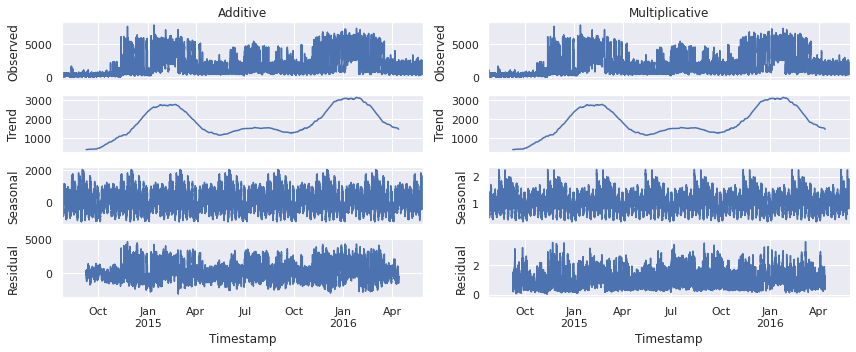

In [ ]:
# Plotting the yearly seasonal decompose
fig, axes = plt.subplots(ncols=2, nrows=4, sharex=True, figsize=(12,5))

plot_seasonal(s_dec_additive, axes[:,0], 'Additive')
plot_seasonal(s_dec_multiplicative, axes[:,1], 'Multiplicative')

plt.tight_layout()
plt.show()

Analysing the results : We  can clearly observe a concrete cyclical pattern from the seasonal graph of each model.

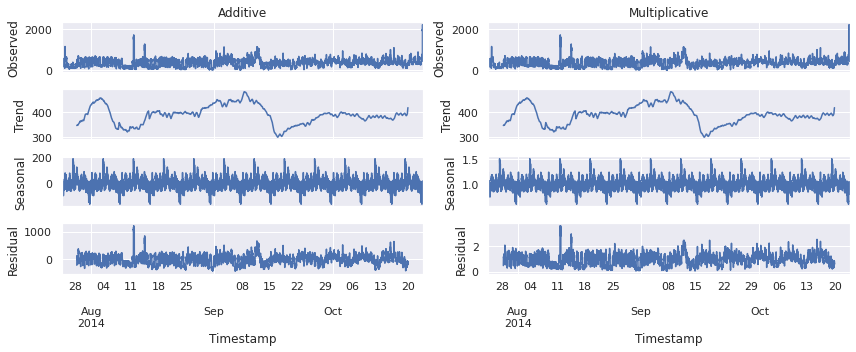

In [ ]:
# Plotting the monthly seasonal decompose
fig, axes = plt.subplots(ncols=2, nrows=4, sharex=True, figsize=(12,5))

plot_seasonal(s_dec_additive_monthly, axes[:,0], 'Additive')
plot_seasonal(s_dec_multiplicative_monthly, axes[:,1], 'Multiplicative')

plt.tight_layout()
plt.show()

Analysing the results : We observe a cyclical pattern in monthly too.

## Stationarity

In the most intuitive sense, stationarity means that the statistical properties of a process generating a time series do not change over time.

It does not mean that the series does not change over time, just that the way it changes does not itself change over time.

**How do we test Stationarity?**

In statistics and econometrics, an **Augmented Dickey–Fuller test (ADF)** tests the null hypothesis that a unit root is present in a time series sample.

The alternative hypothesis is different depending on which version of the test is used, in our case we are testing stationarity.

In [ ]:
import statsmodels.tsa.stattools as sts

The Augmented Dickey–Fuller (ADF) statistic, used in our test, is a negative number. The more negative it is, the stronger the rejection of the hypothesis that there is a unit root at some level of confidence.

In [ ]:
# Running the Adfuller test
adfuller = sts.adfuller(df.energy)

# Extracting the test and critical values
test_value, critical_values = adfuller[0], adfuller[4]

In [ ]:
print(f'The test value : \t{test_value}\nThe critical values : \t{critical_values}')

The test value : 	-11.433694866315143
The critical values : 	{'1%': -3.4304511157430633, '5%': -2.86158469130526, '10%': -2.5667937876647993}


Analysing the results : Our test value is lower than the critical values for 1%, 5% and 10 %.

We reject the null hypothesis. Our data is Stationary.

# Time Series Forecasting

Data Splitting
The Train-set will be 80% and the Test-set 20% of the complete dataframe.

In [ ]:
# Creating a function to split the data into train and test based on a given size
def data_split(df, size):
    return df[:size], df[size:]

# Setting up the size
size = 24162

# Creating the train and test dataframes
train, test = data_split(df_clean, size)

train_hours = len(train)
test_hours = len(test)

print(f'{str(train.energy.tail())} \n\n {str(test.energy.head())}')

Timestamp
2015-04-02 03:45:00+00:00    626.385684
2015-04-02 04:00:00+00:00    592.275573
2015-04-02 04:15:00+00:00    615.532467
2015-04-02 04:30:00+00:00    581.422355
2015-04-02 04:45:00+00:00    707.009584
Name: energy, dtype: float64 

 Timestamp
2015-04-02 05:00:00+00:00    1046.560240
2015-04-02 05:15:00+00:00     820.193136
2015-04-02 05:30:00+00:00    1001.596911
2015-04-02 05:45:00+00:00    1055.862997
2015-04-02 06:00:00+00:00     930.275769
Name: energy, dtype: float64


In [ ]:
# Plotting the dataframes
fig = make_subplots()

fig.add_trace(go.Line(x = train.index, y = train.energy, name = "Train") )

fig.add_trace(go.Line(x = test.index, y = test.energy, name = 'Test'))

fig.update_layout(title = "Energy Consumption of PJM / Train and Test", 
                  yaxis_title="Energy (MW)", 
                  xaxis_title="Date", xaxis_rangeslider_visible=True)

fig.show()